In [ ]:
pip install pillow

In [ ]:
pip install rasterio numpy

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 22.2/22.2 MB 70.8 MB/s eta 0:00:00


In [ ]:
pip install PyWavelets

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 4.5/4.5 MB 38.3 MB/s eta 0:00:00


In [ ]:
import rasterio
from rasterio.warp import calculate_default_transform, reproject, Resampling
import matplotlib.pyplot as plt
import numpy as np

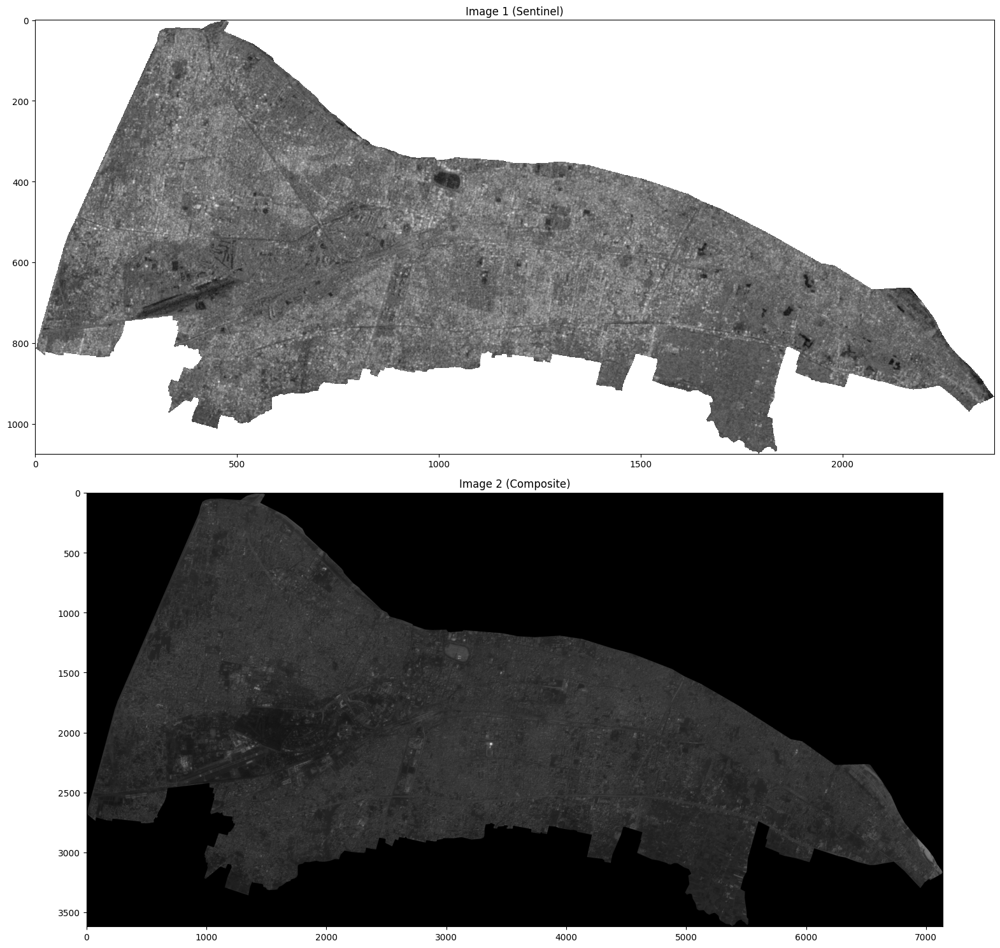

In [ ]:
# Paths to your images
image1_path = "/content/PATNA_SENTINEL1_image.tif"
image2_path = "/content/composite.tif"

# Read and plot both images
with rasterio.open(image1_path) as img1, rasterio.open(image2_path) as img2:
    # Read first band from each image
    image1_array = img1.read(1)
    image2_array = img2.read(1)

# Plot the two images side by side
fig, (ax1, ax2) = plt.subplots(2, 1, figsize=(30, 15))
ax1.imshow(image1_array, cmap="grey")
ax1.set_title("Image 1 (Sentinel)")
ax1.axis("on")

ax2.imshow(image2_array, cmap="grey")
ax2.set_title("Image 2 (Composite)")
ax2.axis("on")

plt.tight_layout()
plt.show()


In [ ]:
image1_array.shape

(1075, 2376)

In [ ]:
image2_array.shape

(3619, 7140)

# Reshaping the image2_array

---



In [ ]:
with rasterio.open(image1_path) as img1, rasterio.open(image2_path) as img2:
    # Define the transform and new dimensions based on image1's specs
    transform, width, height = calculate_default_transform(
        img2.crs, img1.crs, img2.width, img2.height, *img2.bounds
    )

    # Prepare metadata for the reprojected image
    kwargs = img2.meta.copy()
    kwargs.update({
        'crs': img1.crs,
        'transform': transform,
        'width': img1.width,
        'height': img1.height,
        'dtype': img1.dtypes[0]  # Match dtype with Image 1 for compatibility
    })

    # Initialize array to hold the reprojected image data
    resampled_image2 = np.empty((img1.height, img1.width), dtype=img1.dtypes[0])

    # Reproject and resample
    reproject(
        source=rasterio.band(img2, 1),  # Use the first band of Image 2
        destination=resampled_image2,
        src_transform=img2.transform,
        src_crs=img2.crs,
        dst_transform=img1.transform,
        dst_crs=img1.crs,
        resampling=Resampling.bilinear
    )

    # Now read image1 data for fusion
    image1_array = img1.read(1).astype("float32")  # Use the first band of Image 1

# After exiting the 'with' block, image data is available for fusion

In [ ]:
image1_array.shape

(1075, 2376)

In [ ]:
image2_array.shape

(3619, 7140)

In [ ]:
resampled_image2.shape

(1075, 2376)

# 1. Image Fusing by averaging

In [ ]:
with rasterio.open(image1_path) as img1:
    image1_array = img1.read(1).astype("float32")  # Use the first band of Image 1

# Ensure both arrays are normalized if needed (e.g., 0–255 scale for display compatibility)
image1_array /= 255.0
resampled_image2 /= 255.0

# Fuse the images by averaging
fused_array = (image1_array + resampled_image2) / 2

In [ ]:
fused_array.shape

(1075, 2376)

In [ ]:
output_path = "fused_image2.tif"

with rasterio.open(output_path, 'w', **img1.meta) as dst:
    dst.write((fused_array * 255).astype("uint8"), 1)  # Rescale to 0–255 if needed

<ipython-input-18-c1d8c0d04b5a>:4: RuntimeWarning: invalid value encountered in cast
  dst.write((fused_array * 255).astype("uint8"), 1)  # Rescale to 0–255 if needed


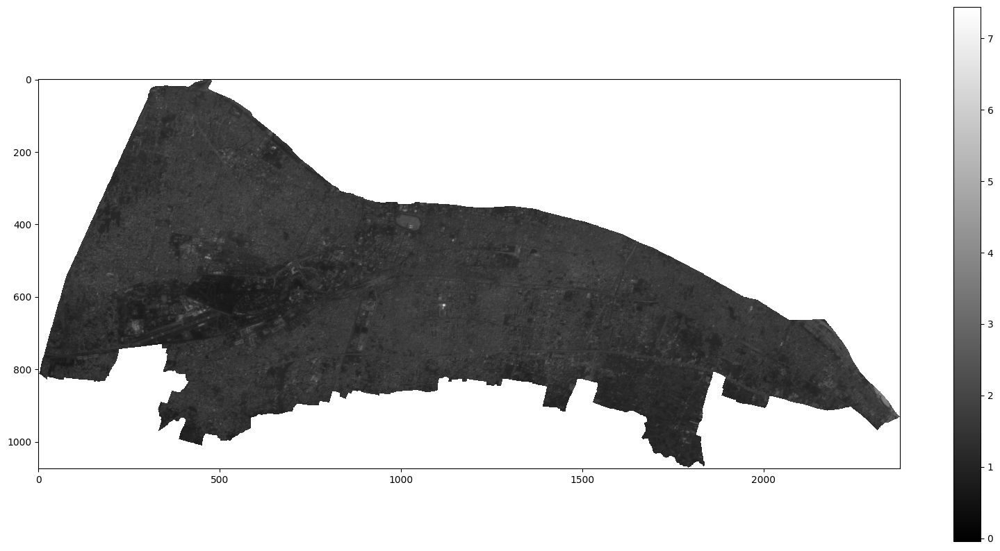

In [ ]:
import matplotlib.pyplot as plt
plt.figure(figsize=(20,10))
plt.imshow(fused_array, cmap="grey")
plt.colorbar()
plt.show()

In [ ]:
from PIL import Image
import numpy as np

# Assuming fused_array contains your fused data normalized to 0-255 range
# Ensure the fused array is in a format compatible with JPEG (single band or RGB)
fused_array = (fused_array * 255).astype(np.uint8)  # Scale to 8-bit if needed

# Save as JPEG
output_jpg_path = "fused_image2.jpg"
Image.fromarray(fused_array).convert("L").save(output_jpg_path)

<ipython-input-20-e393869716bc>:6: RuntimeWarning: invalid value encountered in cast
  fused_array = (fused_array * 255).astype(np.uint8)  # Scale to 8-bit if needed


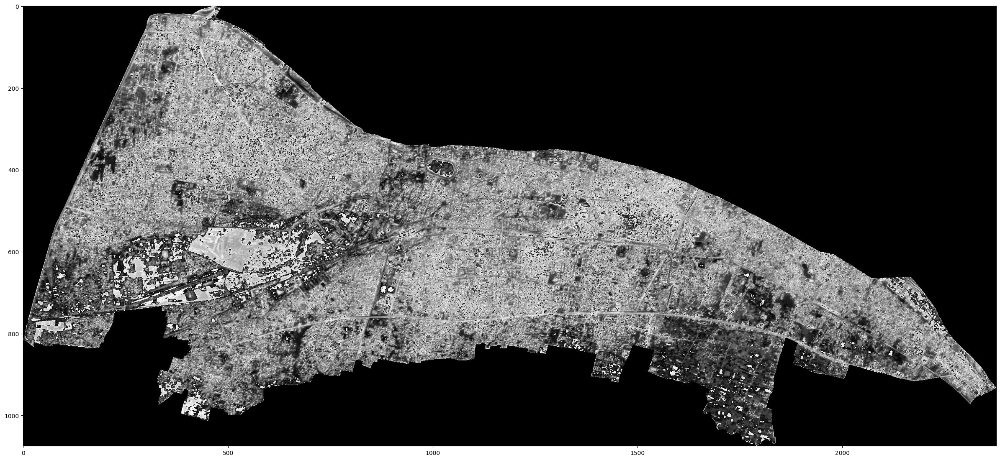

In [ ]:
from PIL import Image
import matplotlib.pyplot as plt

# Load and display the JPEG image
output_jpg_path = "/content/fused_image2.jpg"

# Open and display the image
img = Image.open(output_jpg_path)
plt.figure(figsize=(30,20))
plt.imshow(img, cmap="grey")
plt.axis("on")  # Hide axes for better display
plt.show()

# 2. Principal Component Analysis (PCA) Fusion

In [ ]:
import numpy as np
from sklearn.decomposition import PCA

# Assuming `image1_array` and `resampled_image2` are both grayscale images of shape (1075, 2376)

# Flatten each image to prepare for stacking
flattened_image1 = image1_array.ravel()  # Shape (1075*2376,)
flattened_image2 = resampled_image2.ravel()  # Shape (1075*2376,)

# Stack the two images' pixel intensities into a 2D array for PCA
reshaped_images = np.vstack((flattened_image1, flattened_image2)).T  # Shape (1075*2376, 2)

# Replace NaNs with column means
nan_mask = np.isnan(reshaped_images)
col_means = np.nanmean(reshaped_images, axis=0)
reshaped_images[nan_mask] = np.take(col_means, np.where(nan_mask)[1])

# Apply PCA to reduce the two grayscale images to one fused image
pca = PCA(n_components=1)
pca_result = pca.fit_transform(reshaped_images)  # Shape (1075*2376, 1)

# Reshape the result back to the original image shape
fused_array_pca = pca_result.reshape(image1_array.shape)

# `fused_array_pca` now contains the fused grayscale image with shape (1075, 2376)

In [ ]:
output_path = "fused_image_pca.tif"

with rasterio.open(output_path, 'w', **img1.meta) as dst:
    dst.write((fused_array_pca * 255).astype("uint8"), 1)  # Rescale to 0–255 if needed

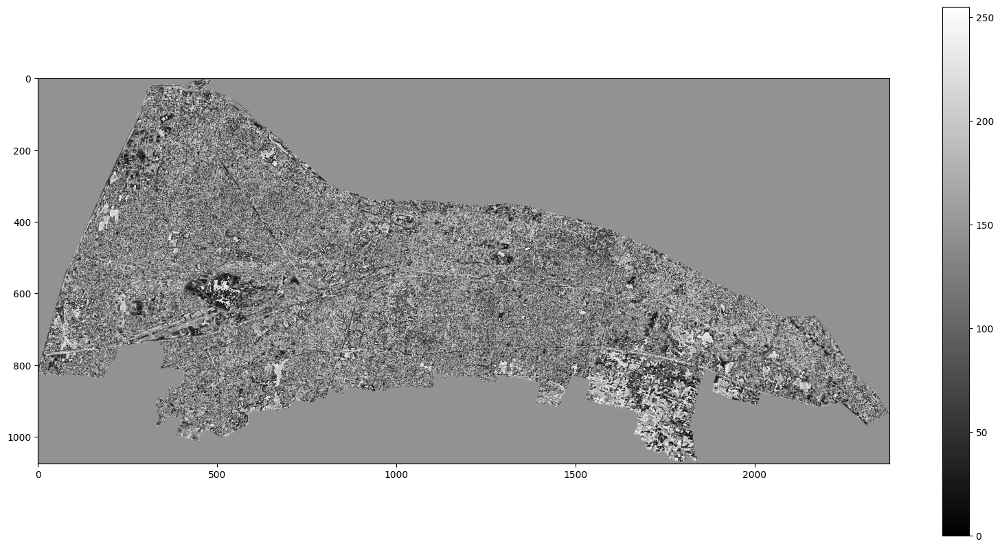

In [ ]:
import matplotlib.pyplot as plt
plt.figure(figsize=(20,10))
plt.imshow(fused_array_pca, cmap="grey")
plt.colorbar()
plt.show()

In [ ]:
# Assuming fused_array contains your fused data normalized to 0-255 range
# Ensure the fused array is in a format compatible with JPEG (single band or RGB)
fused_array_pca = (fused_array_pca * 255).astype(np.uint8)  # Scale to 8-bit if needed

# Save as JPEG
output_jpg_path = "fused_image_pca.jpg"
Image.fromarray(fused_array_pca).convert("L").save(output_jpg_path)

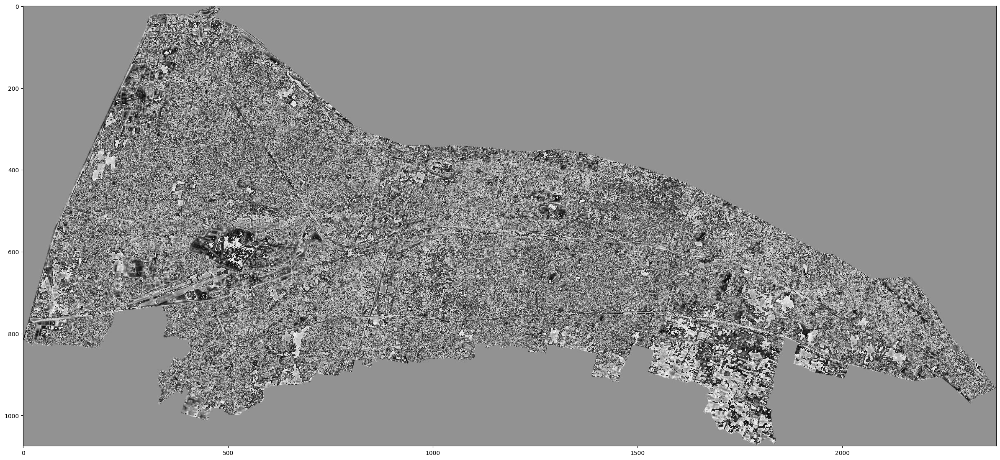

In [ ]:
# Load and display the JPEG image
output_jpg_path = "/content/fused_image_pca.jpg"

# Open and display the image
img = Image.open(output_jpg_path)
plt.figure(figsize=(30,20))
plt.imshow(img, cmap="grey")
plt.axis("on")  # Hide axes for better display
plt.show()

# 3. Weighted Avarage Fusion (Udit)



In [ ]:
import numpy as np

def weighted_average_fusion(image1, image2, weight1=0.7, weight2=0.3):
    """
    Performs weighted average fusion of two images.

    Args:
        image1: First input image (NumPy array).
        image2: Second input image (NumPy array).
        weight1: Weight for the first image (default: 0.5).
        weight2: Weight for the second image (default: 0.5).

    Returns:
        The fused image (NumPy array).
    """
    # Ensure weights sum to 1
    weight1 = weight1 / (weight1 + weight2)
    weight2 = weight2 / (weight1 + weight2)

    # Perform fusion
    fused_image = weight1 * image1 + weight2 * image2
    return fused_image

In [ ]:
output_path = "fused_image_weighted_avg.tif"

with rasterio.open(output_path, 'w', **img1.meta) as dst:
    dst.write((fused_array * 255).astype("uint8"), 1)

In [ ]:
# Assuming fused_array contains your fused data normalized to 0-255 range
# Ensure the fused array is in a format compatible with JPEG (single band or RGB)
fused_array = (fused_array * 255).astype(np.uint8)  # Scale to 8-bit if needed

# Save as JPEG
output_jpg_path = "fused_image_weighted_avg.jpg"
Image.fromarray(fused_array).convert("L").save(output_jpg_path)

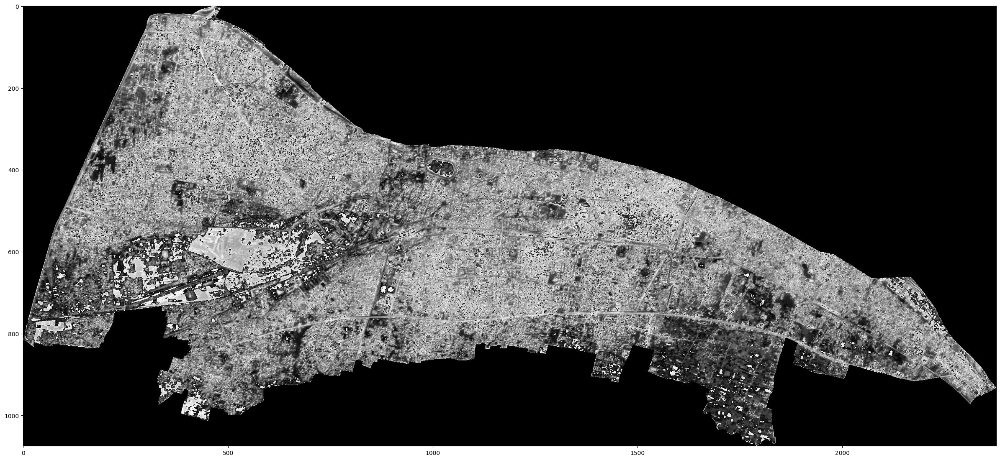

In [ ]:
# Load and display the JPEG image
output_jpg_path = "/content/fused_image_weighted_avg.jpg"

# Open and display the image
img = Image.open(output_jpg_path)
plt.figure(figsize=(30,20))
plt.imshow(img, cmap="grey")
plt.axis("on")  # Hide axes for better display
plt.show()

4. wavelet Fusion(Aashish)

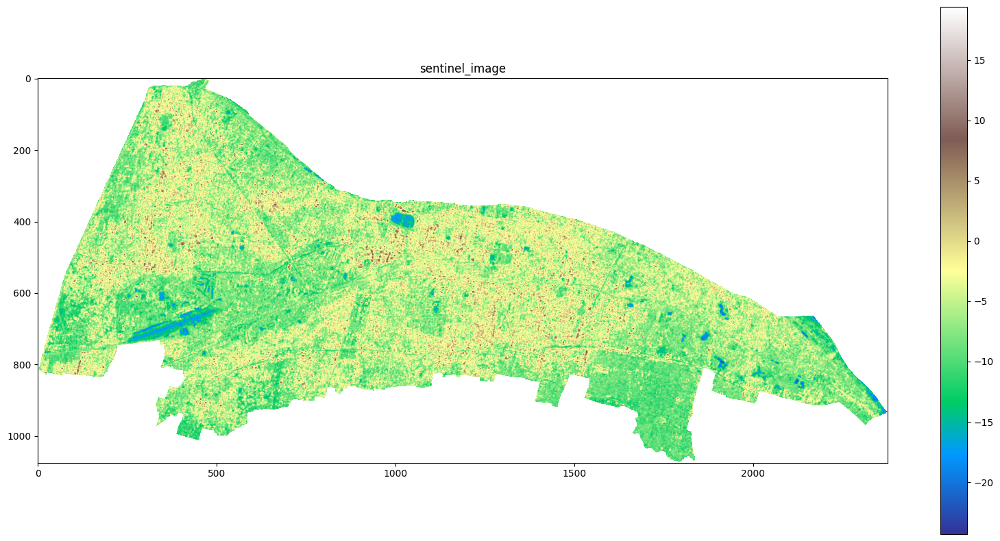

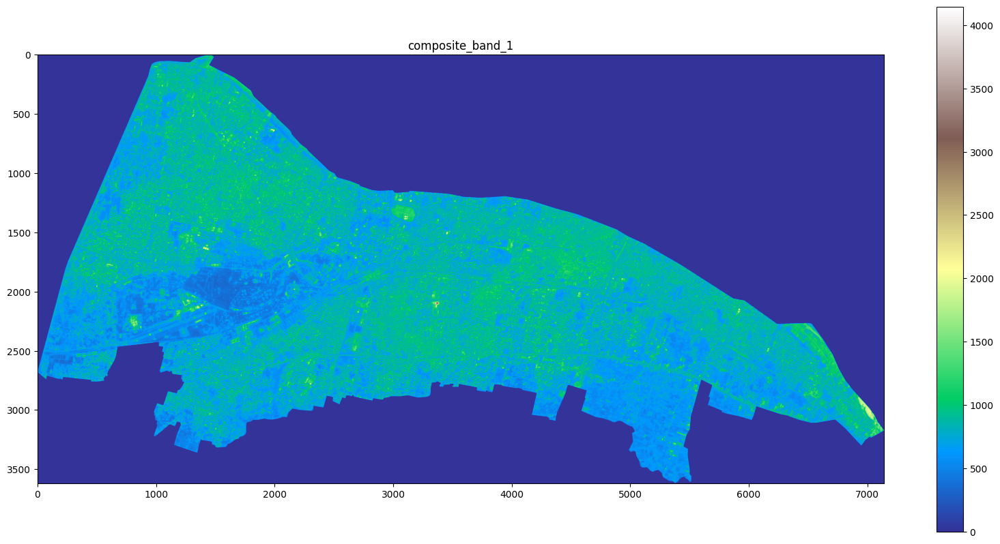

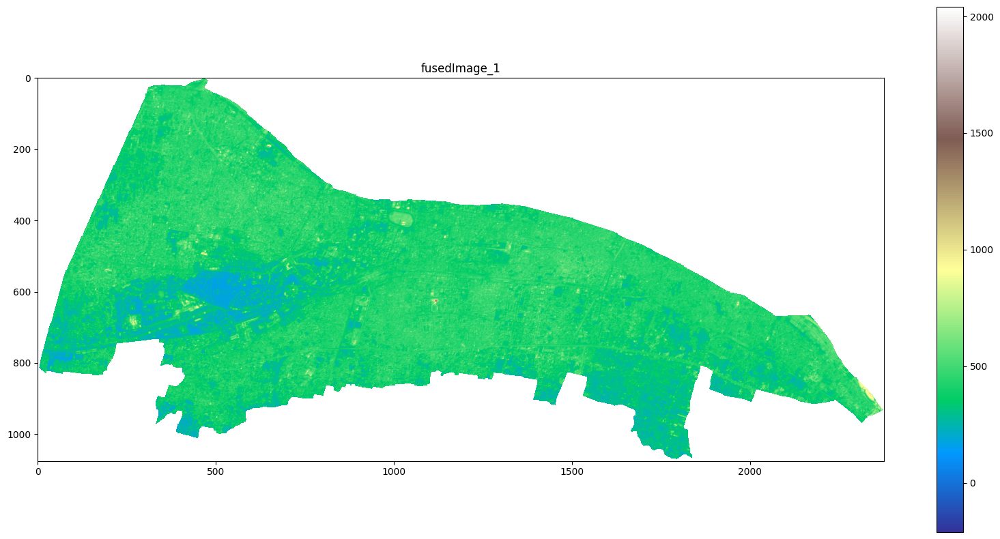

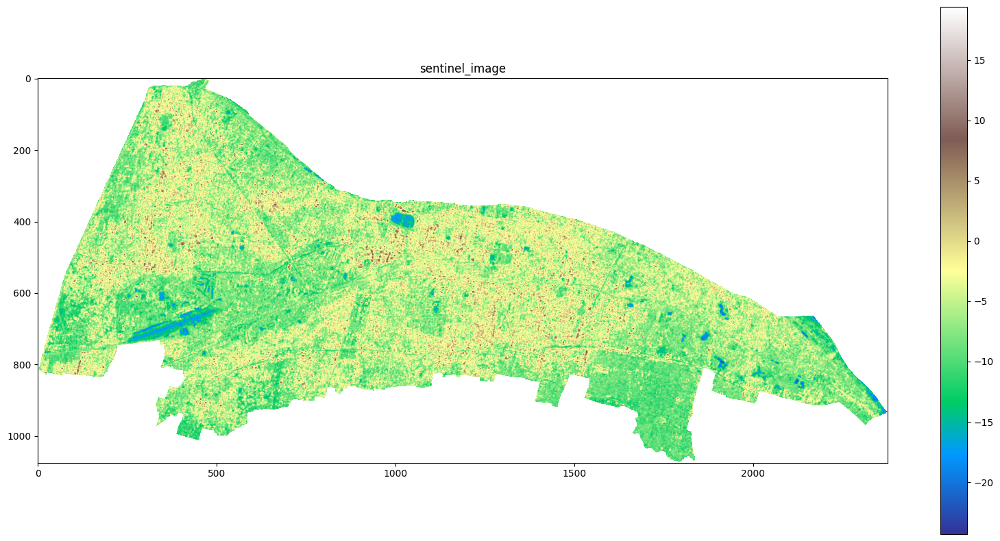

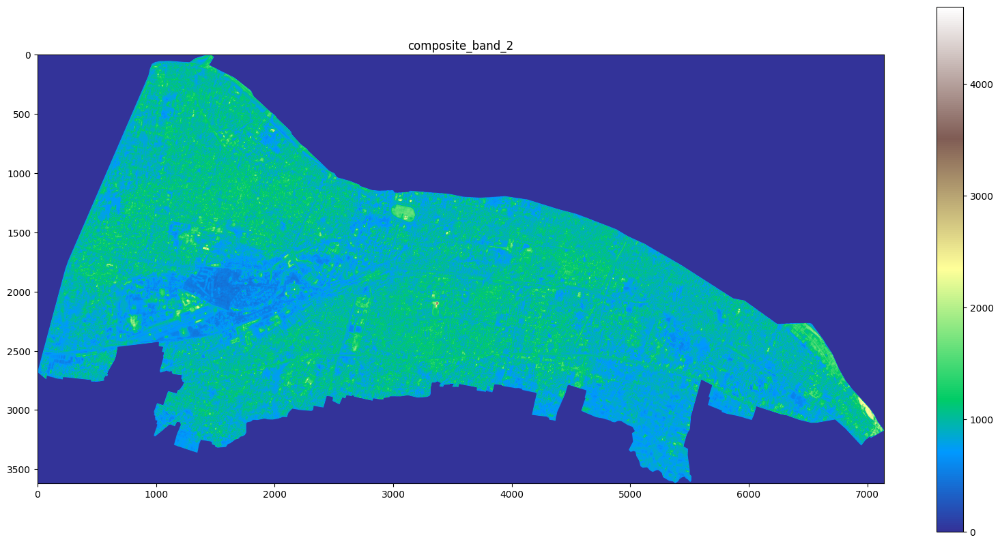

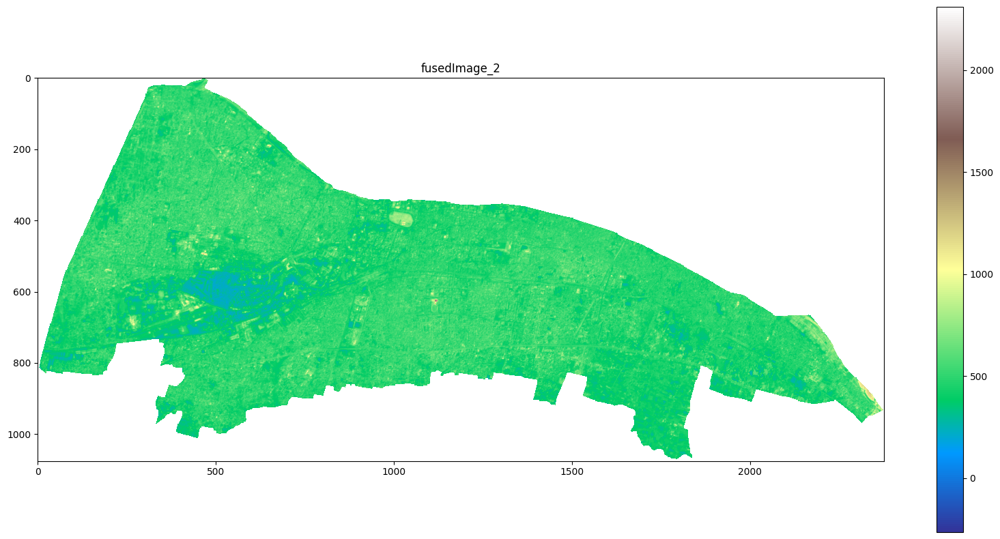

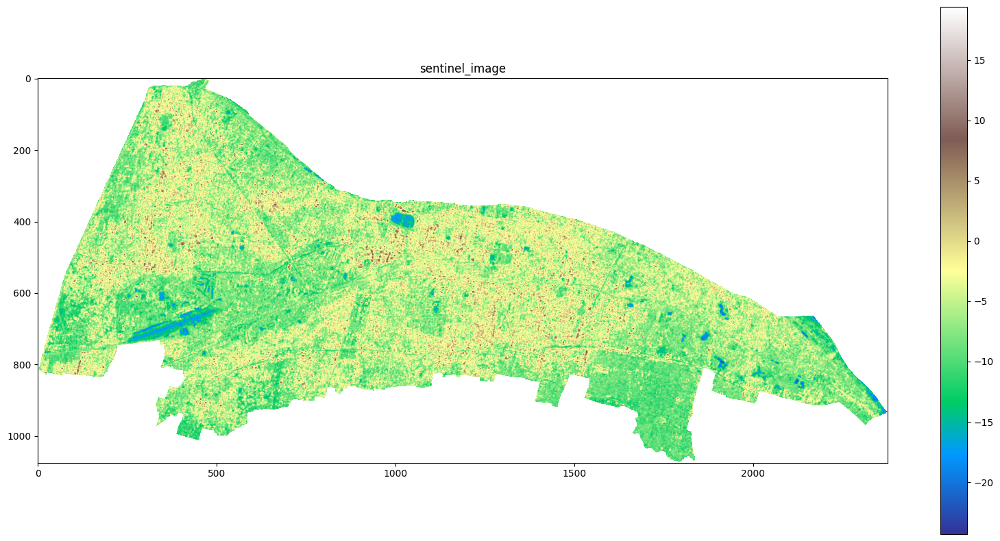

In [ ]:

from osgeo import gdal
import matplotlib.pyplot as plt
import numpy as np
import sys
import pywt

def readImage(imagePath):
  image = gdal.Open(imagePath)
  if image is None:
      print('Could not open')
      sys.exit(1)
  return image

def checkFeatures(image):
  print(image.RasterCount) #no of band
  print(image.RasterXSize)
  print(image.RasterYSize)
  print(image.GetGeoTransform())
  print(image.GetProjection())

  # 2nd method to check band
  arr = image.ReadAsArray()
  print(arr.shape)

  if len(arr.shape) == 2:  # Single-band image
    print(f"No of band = 1" )
  elif len(arr.shape) == 3 and arr.shape[0] >= 3:  # Multi-band image
    print(f"No of band = {arr.shape[0]}")
  else:
    print("Image format not recognized for display.")

def getFeatures(image):
  return  image.GetGeoTransform(), image.GetProjection(), image.RasterXSize, image.RasterYSize

def getImageArr(image,offset):
    band = image.GetRasterBand(offset)
    imageArr = band.ReadAsArray()
    return imageArr

def plotImage(imageArr,title):
  plt.figure(figsize=(20,10))
  plt.imshow(imageArr, cmap='terrain')
  plt.colorbar()
  plt.title(title)
  plt.show()

def resampleImage(source_image, source_transform, source_projection, target_dataset):
    target_transform = target_dataset.GetGeoTransform()
    target_projection = target_dataset.GetProjection()
    target_xsize = target_dataset.RasterXSize
    target_ysize = target_dataset.RasterYSize

    # Create in-memory file for resampling
    mem_driver = gdal.GetDriverByName('MEM')
    source_dataset = mem_driver.Create('', source_image.shape[1], source_image.shape[0], 1, gdal.GDT_Float32)
    source_dataset.GetRasterBand(1).WriteArray(source_image)
    source_dataset.SetGeoTransform(source_transform)
    source_dataset.SetProjection(source_projection)

    # Resample to match target spatial properties
    resampled_dataset = mem_driver.Create('', target_xsize, target_ysize, 1, gdal.GDT_Float32)
    resampled_dataset.SetGeoTransform(target_transform)
    resampled_dataset.SetProjection(target_projection)
    gdal.ReprojectImage(source_dataset, resampled_dataset, source_projection, target_projection, gdal.GRA_Bilinear)

    return resampled_dataset.GetRasterBand(1).ReadAsArray()

def waveletFusion1(singleBandImagArr, multiBandImageArr, wavelet='db1'):

      # Perform wavelet decomposition on each band of the multi-band image and the single-band image
      coeffs1 = pywt.dwt2(singleBandImagArr, wavelet)
      coeffs2 = pywt.dwt2(multiBandImageArr, wavelet)
      A1, (H1, V1, D1) = coeffs1
      A2, (H2, V2, D2) = coeffs2

        # Fusion rules: Averaging for approximation, maximum for detail
      fused_A = (A1 + A2) / 2
      fused_H = np.maximum(H1, H2)
      fused_V = np.maximum(V1, V2)
      fused_D = np.maximum(D1, D2)

        # Reconstruct the fused band using inverse wavelet transform
      fused_image = pywt.idwt2((fused_A, (fused_H, fused_V, fused_D)), wavelet)

      return fused_image

def main(imagePath1,imagePath2,outputPath):

  image1 = readImage(imagePath1)
  image2 = readImage(imagePath2)

  #checkFeatures(image1)
  #checkFeatures(image2)

  #displayBandwise(image1)
  #displayBandwise(image2)

  singleBandArr = getImageArr(image1,1)
  singleGeotransform, singleProjection, singleXsize, singleYsize = getFeatures(image1)

  for i in range(1,image2.RasterCount):
    multiBandArr = getImageArr(image2,i)
    multiGeotransform, multiProjection, multiXsize, multiYsize = getFeatures(image2)
    resampledImage2 = resampleImage(multiBandArr, multiGeotransform,multiProjection,image1)
    plotImage(singleBandArr,"sentinel_image")
    plotImage(multiBandArr,f"composite_band_{i}")
    fusedImage = waveletFusion1(singleBandArr, resampledImage2)
    plotImage(fusedImage,f"fusedImage_{i}")
    #plt.savefig(outputPath, dpi=300, bbox_inches='tight')

imagePath1 = '/content/PATNA_SENTINEL1_image.tif'
imagePath2 = 'sample_data/composite.tif'
outputPath = 'sample_data/fused.tif'
main(imagePath1,imagePath2,outputPath)

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

# 5. Image Band fusion (Sourabh Kumar Prajapati)

 1.Load necessary packages

In [ ]:
!pip install rasterio
import rasterio

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 22.2/22.2 MB 76.6 MB/s eta 0:00:00


In [ ]:
from tifffile import tifffile
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd

2. Load the dataset

In [ ]:
with rasterio.open("composite.tif") as img:
  img2=img.read()

In [ ]:
img2.shape

(4, 3619, 7140)

3.Analysis of dataset in "composite.tif"

In [ ]:
df=pd.DataFrame({'min_':[np.nanmin(np.where(i<=0,np.nan,i)) for i in img2],
                 'max_':[np.nanmax(np.where(i<=0,np.nan,i)) for i in img2],
                 'std_':[np.nanstd(np.where(i<=0,np.nan,i)) for i in img2],
                 'q_0.25':[np.nanquantile(np.where(i<=0,np.nan,i),0.25) for i in img2],
                 'q_0.75':[np.nanquantile(np.where(i<=0,np.nan,i),0.75) for i in img2]

             },index=['band_1','band_2','band_3','band_4'])
df['final_min']=df['q_0.25']-df.std_*3
df['final_max']=df['q_0.75']+df.std_*3
display(df)

,min_,max_,std_,q_0.25,q_0.75,final_min,final_max
band_1,231.0,4148.0,171.610593,678.0,899.0,163.168221,1413.831779
band_2,329.0,4690.0,192.955993,834.0,1070.0,255.132022,1648.867978
band_3,342.0,5620.0,269.785684,939.0,1283.0,129.642947,2092.357053
band_4,324.0,15234.0,509.749528,1709.0,2277.0,179.751417,3806.248583


Note: print the min, max, sigma(std), 25% quantile, 75% quantile and final range take (+-)3*sigma

 In remote sensing, typical formats include:

1. Visible light: ~400–700 nm.
2. Near-infrared (NIR): ~700–1400 nm.
3. Mid-IR: ~1400–3000 nm.
4. Thermal IR: ~8000–15000 nm.

4.Histogram Plot

Challanges: Kde plot takes too much time due to large dataset size. So best approach is Histogram plot.

* before change the range

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

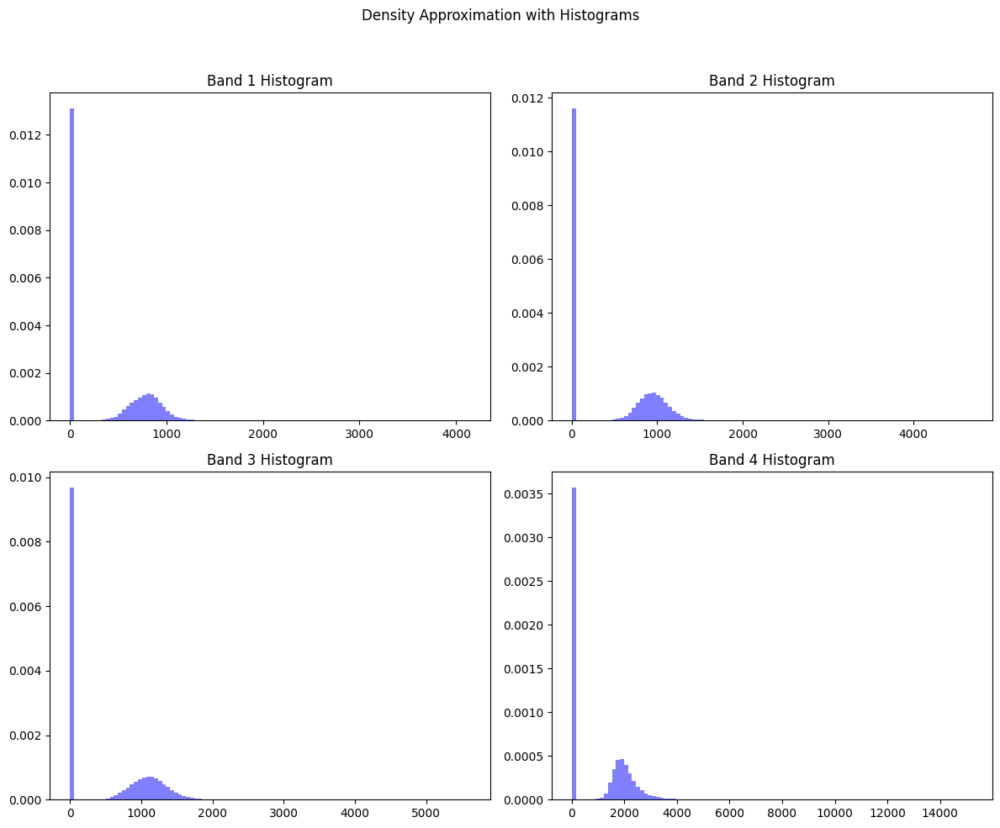

In [ ]:
%matplotlib inline
b1,b2,b3,b4=img2[0],img2[1],img2[2],img2[3]
plt.figure(figsize=(12, 10))
plt.subplot(2, 2, 1)
plt.hist(b1.flatten(), bins=100, density=True, color="blue", alpha=0.5)
plt.title("Band 1 Histogram")

plt.subplot(2, 2, 2)
plt.hist(b2.flatten(), bins=100, density=True, color="blue", alpha=0.5)
plt.title("Band 2 Histogram")

plt.subplot(2, 2, 3)
plt.hist(b3.flatten(), bins=100, density=True, color="blue", alpha=0.5)
plt.title("Band 3 Histogram")

plt.subplot(2, 2, 4)
plt.hist(b4.flatten(), bins=100, density=True, color="blue", alpha=0.5)
plt.title("Band 4 Histogram")

plt.suptitle("Density Approximation with Histograms")
plt.tight_layout(rect=[0, 0, 1, 0.95])
plt.show()

* remove zeros and plot

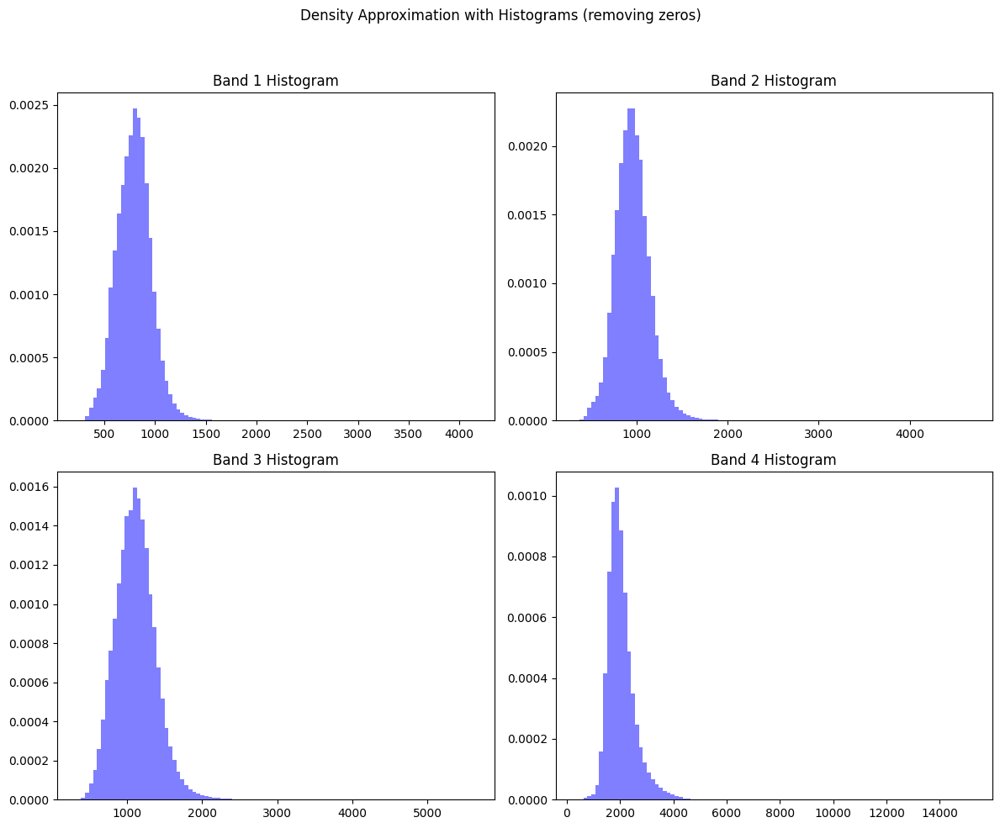

In [ ]:
%matplotlib inline
b1,b2,b3,b4=img2[0],img2[1],img2[2],img2[3]
b1=np.where(b1<=0,np.nan,b1)
b2=np.where(b2<=0,np.nan,b2)
b3=np.where(b3<=0,np.nan,b3)
b4=np.where(b4<=0,np.nan,b4)

plt.figure(figsize=(12, 10))
plt.subplot(2, 2, 1)
plt.hist(b1.flatten(), bins=100, density=True, color="blue", alpha=0.5)
plt.title("Band 1 Histogram")

plt.subplot(2, 2, 2)
plt.hist(b2.flatten(), bins=100, density=True, color="blue", alpha=0.5)
plt.title("Band 2 Histogram")

plt.subplot(2, 2, 3)
plt.hist(b3.flatten(), bins=100, density=True, color="blue", alpha=0.5)
plt.title("Band 3 Histogram")

plt.subplot(2, 2, 4)
plt.hist(b4.flatten(), bins=100, density=True, color="blue", alpha=0.5)
plt.title("Band 4 Histogram")

plt.suptitle("Density Approximation with Histograms (removing zeros)")
plt.tight_layout(rect=[0, 0, 1, 0.95])
plt.show()

* convert the range between (+/-)3*sigma

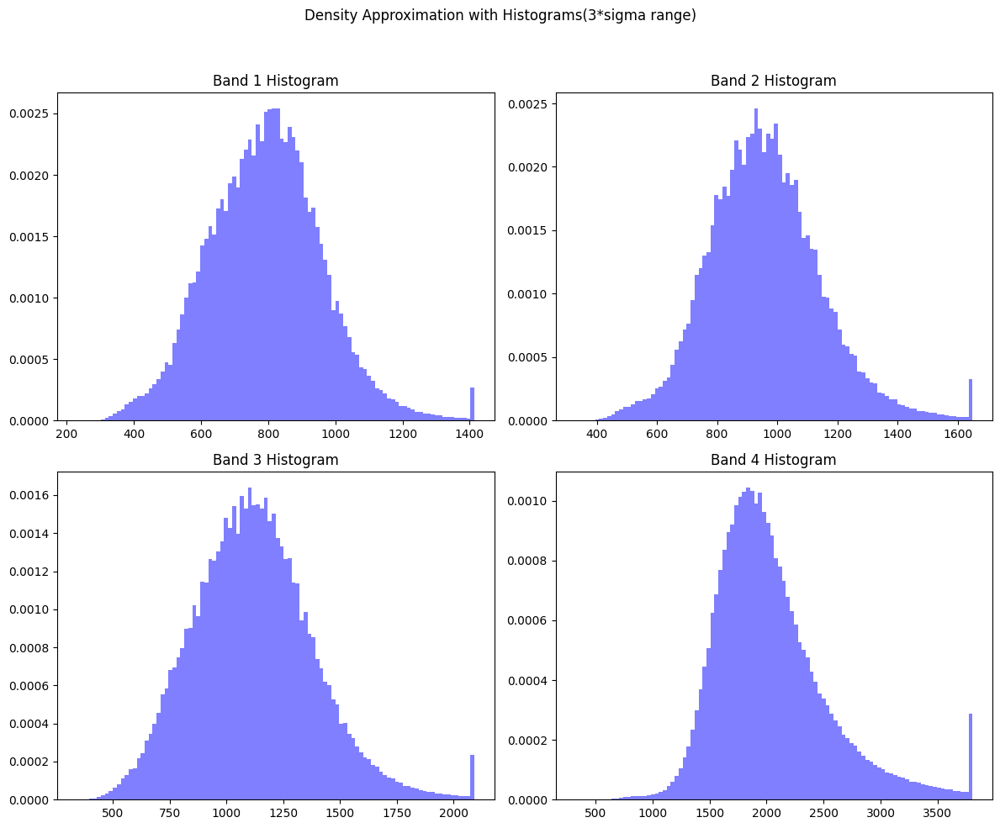

In [ ]:
%matplotlib inline
# new_image=np.stack([np.where((b<df.loc[band,'final_min'])|(b>df.loc[band,'final_max']),np.nan,b) for b,band in zip(img2,df.index)])
img=np.where(np.isin(img2,0),np.nan,img2)
new_image=np.stack([np.clip(b,df.loc[band,'final_min'],df.loc[band,'final_max']) for b,band in zip(img,df.index)])
b1,b2,b3,b4=new_image[0],new_image[1],new_image[2],new_image[3]
plt.figure(figsize=(12, 10))
plt.subplot(2, 2, 1)
plt.hist(b1.flatten(), bins=100, density=True, color="blue", alpha=0.5)
plt.title("Band 1 Histogram")

plt.subplot(2, 2, 2)
plt.hist(b2.flatten(), bins=100, density=True, color="blue", alpha=0.5)
plt.title("Band 2 Histogram")

plt.subplot(2, 2, 3)
plt.hist(b3.flatten(), bins=100, density=True, color="blue", alpha=0.5)
plt.title("Band 3 Histogram")

plt.subplot(2, 2, 4)
plt.hist(b4.flatten(), bins=100, density=True, color="blue", alpha=0.5)
plt.title("Band 4 Histogram")

plt.suptitle("Density Approximation with Histograms(3*sigma) range")
plt.tight_layout(rect=[0, 0, 1, 0.95])
plt.show()

In [ ]:
np.nanmax(new_image)

3806.2485830838627

In [ ]:
# convert this image in range 0-1
new_image_=np.stack([(img-np.nanmin(img))/(np.nanmax(img)-np.nanmin(img)) for img in new_image])

In [ ]:
np.nanmin(new_image_),np.nanmax(new_image_)

(0.0, 1.0)

5. Try to make different combinations

challanges: image data type (float, int), range of data in all the bands is take lots of time. It's little bit confusing.

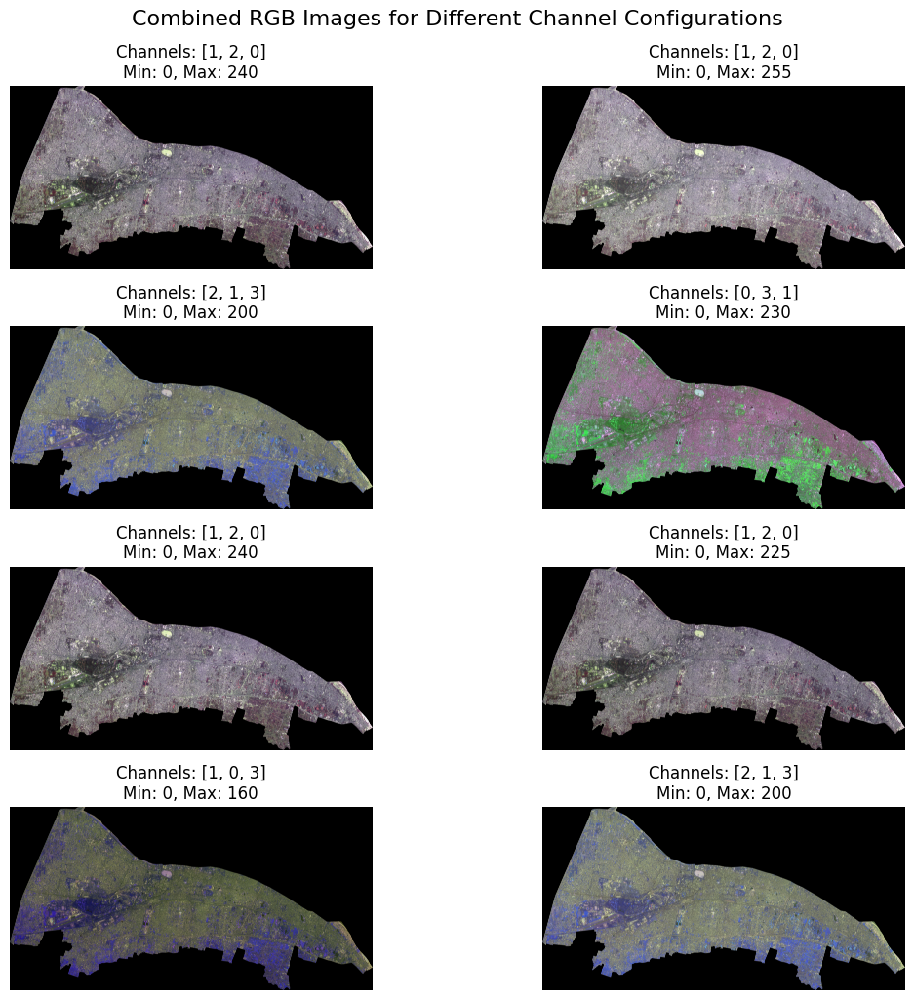

In [ ]:
%matplotlib inline
channel_configs = [
    [1, 2, 0, 220, 20],  # First configuration
    [1, 2, 0, 200, 55],  # Second configuration
    [2, 1, 3, 150, 50],  # Third configuration
    [0, 3, 1, 200, 30],   # Fourth configuration
    [1, 2, 0, 220, 20],  # Standard scaling and offset
    [1, 2, 0, 200, 25],  # Higher contrast
    [1, 0, 3, 150, 10],  # Lower contrast
    [2, 1, 3, 150, 50]  # Increased brightness
]

# Create a 2x2 subplot grid
fig, axes = plt.subplots(4, 2, figsize=(12, 10),sharex=True, sharey=True)

for idx, config in enumerate(channel_configs):
    channels = config[:3]
    scale = config[3]
    offset = config[4]

    # Generate the image
    new_image1 = np.stack([
        new_image_[channels[0]] * scale + offset,
        new_image_[channels[1]] * scale + offset,
        new_image_[channels[2]] * scale + offset
    ], axis=2)

    new_image1 = np.nan_to_num(new_image1, nan=0)
    new_image1 = np.clip(new_image1, 0, 255).astype(np.uint8)

    ax = axes[idx // 2, idx % 2]
    ax.imshow(new_image1)
    ax.set_title(f"Channels: {channels}\nMin: {np.min(new_image1)}, Max: {np.max(new_image1)}")
    ax.axis("off")

# Adjust layout
plt.tight_layout()
plt.suptitle("Combined RGB Images for Different Channel Configurations", fontsize=16, y=1.02)
plt.show()

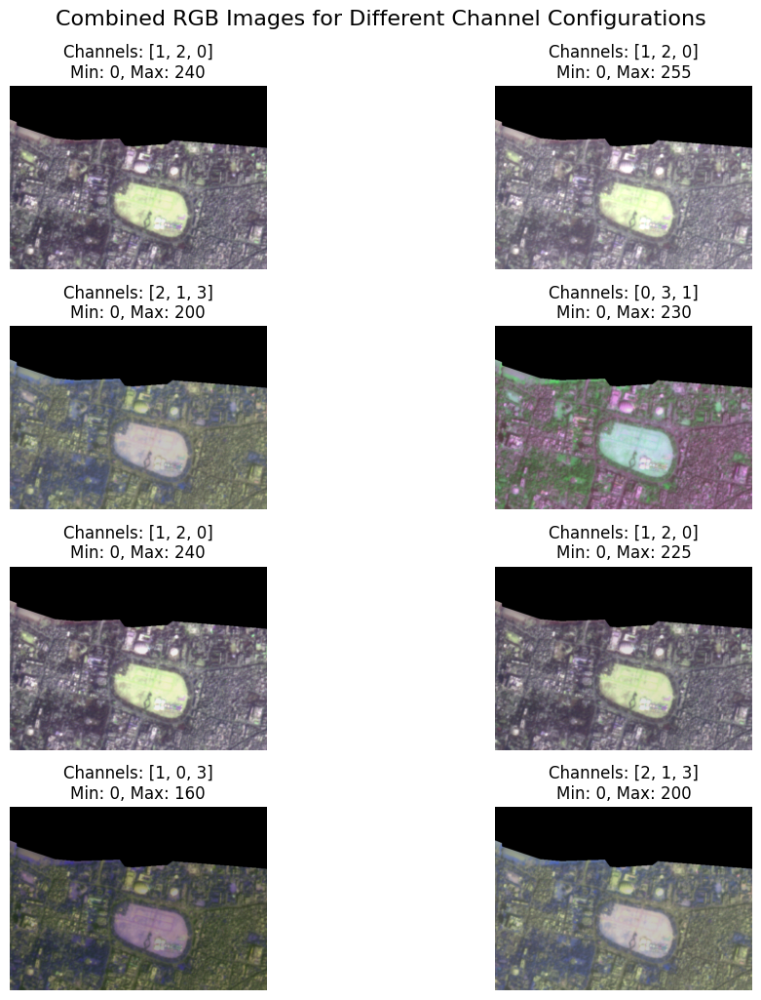

In [ ]:
%matplotlib inline
channel_configs = [
    [1, 2, 0, 220, 20],  # First configuration
    [1, 2, 0, 200, 55],  # Second configuration
    [2, 1, 3, 150, 50],  # Third configuration
    [0, 3, 1, 200, 30],   # Fourth configuration
    [1, 2, 0, 220, 20],  # Standard scaling and offset
    [1, 2, 0, 200, 25],  # Higher contrast
    [1, 0, 3, 150, 10],  # Lower contrast
    [2, 1, 3, 150, 50]  # Increased brightness
]

# Create a 2x2 subplot grid
fig, axes = plt.subplots(4, 2, figsize=(12, 10),sharex=True, sharey=True)

for idx, config in enumerate(channel_configs):
    channels = config[:3]
    scale = config[3]
    offset = config[4]

    # Generate the image
    new_image1 = np.stack([
        new_image_[channels[0]] * scale + offset,
        new_image_[channels[1]] * scale + offset,
        new_image_[channels[2]] * scale + offset
    ], axis=2)

    new_image1 = np.nan_to_num(new_image1, nan=0)
    new_image1 = np.clip(new_image1, 0, 255).astype(np.uint8)
    crop=[1000,1500,2700,3400]
    new_image1 = new_image1[crop[0]:crop[1],crop[2]:crop[3]]
    ax = axes[idx // 2, idx % 2]
    ax.imshow(new_image1)
    ax.set_title(f"Channels: {channels}\nMin: {np.min(new_image1)}, Max: {np.max(new_image1)}")
    ax.axis("off")

# Adjust layout
plt.tight_layout()
plt.suptitle("Combined RGB Images for Different Channel Configurations", fontsize=16, y=1.02)
plt.show()

Text(0.5, 1.0, "'image_min:',0,'image_max:',240, 'channels:',[1, 2, 0]")

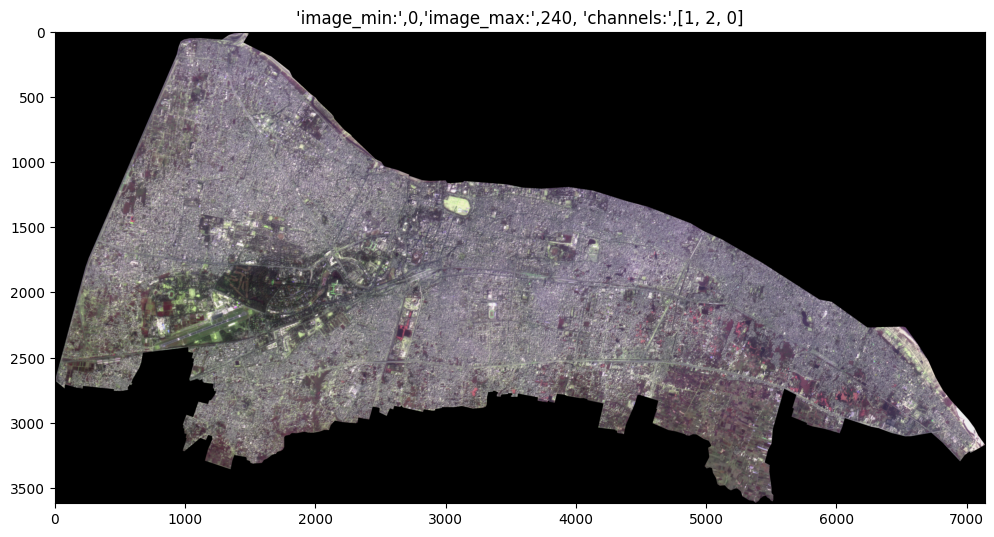

In [ ]:
channels=[1,2,0]
new_image1=np.stack([new_image_[channels[0]]*220+20,new_image_[channels[1]]*220+20,new_image_[channels[2]]*220+20],axis=2)
new_image1=np.nan_to_num(new_image1,nan=0)

# convert the datatype from float to int
# without convert the data in appropriate fromat
# error:Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
new_image1=new_image1.astype(int)

%matplotlib inline
plt.figure(figsize=(12,8))
plt.imshow(new_image1)
plt.title(f"'image_min:',{np.nanmin(new_image1)},'image_max:',{np.nanmax(new_image1)}, 'channels:',{channels}")